<a href="https://colab.research.google.com/github/gayathri1462/Data-Analysis-Projects/blob/main/uber_pickups_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import Libraries

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")
import os

## Data Loading

In [4]:
#List of files in the directory
os.listdir("./uber-pickups-in-new-york-city")

['other-Dial7_B00887.csv',
 'Uber-Jan-Feb-FOIL.csv',
 'other-American_B01362.csv',
 'other-Carmel_B00256.csv',
 'other-Diplo_B01196.csv',
 'other-Federal_02216.csv',
 'other-FHV-services_jan-aug-2015.csv',
 'other-Highclass_B01717.csv',
 'other-Lyft_B02510.csv',
 'other-Firstclass_B01536.csv',
 'other-Prestige_B01338.csv',
 'other-Skyline_B00111.csv',
 'uber-raw-data-aug14.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [5]:
#Get uber raw data files in the directory
files=os.listdir("./uber-pickups-in-new-york-city")[12:]
files

['uber-raw-data-aug14.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-janjune-15.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

In [6]:
files.remove('uber-raw-data-janjune-15.csv')
files

['uber-raw-data-aug14.csv',
 'uber-raw-data-apr14.csv',
 'uber-raw-data-jul14.csv',
 'uber-raw-data-jun14.csv',
 'uber-raw-data-may14.csv',
 'uber-raw-data-sep14.csv']

## Creating Dataframe

In [7]:
#Creating dataframe
path = r"./uber-pickups-in-new-york-city"
final_df=pd.DataFrame()
for file in files:
    df=pd.read_csv(path+"/"+file,encoding="utf-8")
    final_df = pd.concat([final_df,df])

In [8]:
final_df.shape

(4534327, 4)

###  Data Preparation

##### Lat : The latitude of the Uber pickup

##### Lon : The longitude of the Uber pickup

##### Base : The TLC base company code affiliated with the Uber pickup

##### The globe is split into an imaginary 360 sections from both top to bottom (north to south) and 180 sections from side to side (west to east). The sections running from top to bottom on a globe are called longitude, and the sections running from side to side on a globe are called latitude.


##### Latitude is the measurement of distance north or south of the Equator.

##### Every location on earth has a global address. Because the address is in numbers, people can communicate about location no matter what language they might speak. A global address is given as two numbers called coordinates. The two numbers are a location's latitude number and its longitude number ("Lat/Long").

In [9]:
df=final_df.copy()

In [10]:
df.head()

,Date/Time,Lat,Lon,Base
0,8/1/2014 0:03:00,40.7366,-73.9906,B02512
1,8/1/2014 0:09:00,40.7260,-73.9918,B02512
2,8/1/2014 0:12:00,40.7209,-74.0507,B02512
3,8/1/2014 0:12:00,40.7387,-73.9856,B02512
4,8/1/2014 0:12:00,40.7323,-74.0077,B02512


In [11]:
df.shape

(4534327, 4)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Dtype  
---  ------     -----  
 0   Date/Time  object 
 1   Lat        float64
 2   Lon        float64
 3   Base       object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


In [13]:
df.isna().sum()

Date/Time    0
Lat          0
Lon          0
Base         0
dtype: int64

In [14]:
df['Date/Time'] = pd.to_datetime(df['Date/Time'], format="%m/%d/%Y %H:%M:%S")

In [15]:
df.dtypes

Date/Time    datetime64[ns]
Lat                 float64
Lon                 float64
Base                 object
dtype: object

In [16]:
df['Day']=df['Date/Time'].dt.day_name()
df['Date']=df['Date/Time'].dt.day
df['Month']=df['Date/Time'].dt.month_name()
df['Minute']=df['Date/Time'].dt.minute
df['Hour']=df['Date/Time'].dt.hour

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 9 columns):
 #   Column     Dtype         
---  ------     -----         
 0   Date/Time  datetime64[ns]
 1   Lat        float64       
 2   Lon        float64       
 3   Base       object        
 4   Day        object        
 5   Date       int64         
 6   Month      object        
 7   Minute     int64         
 8   Hour       int64         
dtypes: datetime64[ns](1), float64(2), int64(3), object(3)
memory usage: 345.9+ MB


In [18]:
df.head()

,Date/Time,Lat,Lon,Base,Day,Date,Month,Minute,Hour
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,Friday,1,August,3,0
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,Friday,1,August,9,0
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,Friday,1,August,12,0
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,Friday,1,August,12,0
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,Friday,1,August,12,0


In [19]:
df['Base'].unique()

array(['B02512', 'B02598', 'B02617', 'B02682', 'B02764'], dtype=object)

In [20]:
df['Day'].unique()

array(['Friday', 'Saturday', 'Sunday', 'Monday', 'Tuesday', 'Wednesday',
       'Thursday'], dtype=object)

In [21]:
df['Date'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31])

In [22]:
df['Month'].unique()

array(['August', 'April', 'July', 'June', 'May', 'September'],
      dtype=object)

In [23]:
df.rename(columns = {'Lat':'Latitude', 'Lon':'Longitude'}, inplace = True)

In [24]:
df.head()

,Date/Time,Latitude,Longitude,Base,Day,Date,Month,Minute,Hour
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,Friday,1,August,3,0
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,Friday,1,August,9,0
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,Friday,1,August,12,0
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,Friday,1,August,12,0
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,Friday,1,August,12,0


### Analysis of Daily Rides

In [25]:
#!pip install plotly
import plotly.express as px

In [26]:
df['Day'].value_counts()

Thursday     755145
Friday       741139
Wednesday    696488
Tuesday      663789
Saturday     646114
Monday       541472
Sunday       490180
Name: Day, dtype: int64

In [27]:
week_df =pd.DataFrame()
week_df ['Week Days']=df['Day'].value_counts().index
week_df ['Daily Rides']=df['Day'].value_counts().values
week_df.head()

,Week Days,Daily Rides
0,Thursday,755145
1,Friday,741139
2,Wednesday,696488
3,Tuesday,663789
4,Saturday,646114


In [28]:
fig = px.bar(week_df,x='Week Days',y='Daily Rides',title="Analysis of Daily Rides")
fig.show()

#### Observation: The number of pickups is highest on Thursday followed by Friday and lowest on Sunday. So, The Uber pickups are high during the work days compared to weekends

### Analysis of Hourly Rides

In [29]:
df['Hour'].value_counts()

17    336190
18    324679
16    313400
19    294513
20    284604
21    281460
15    275466
22    241858
14    230625
13    195877
7     193094
8     190504
12    170452
23    169190
11    165703
9     159967
10    159148
6     143213
0     103836
5      83939
1      67227
4      55230
3      48287
2      45865
Name: Hour, dtype: int64

In [30]:
hour_df =pd.DataFrame()
hour_df['Hour']=df['Hour'].value_counts().index
hour_df['Hourly Rides']=df['Hour'].value_counts().values
hour_df.head()

,Hour,Hourly Rides
0,17,336190
1,18,324679
2,16,313400
3,19,294513
4,20,284604


In [31]:
fig = px.bar(hour_df,x='Hour',y='Hourly Rides',title="Analysis of Hourly Rides")
fig.show()

#### Observation: The number of pickups is very high during evening from 4pm to 6pm when people are logging off from work and is very low during the night from 1am to 5am. 

##  Analysis of Hourly Rides in each month

In [32]:
month=list(df["Month"].unique())
each_month_hourly_rides_df =pd.DataFrame()
for i in range(6):
    each_month_hourly_rides_df['Hours in {}'.format(month[i])]=df[df['Month']==month[i]]["Hour"].value_counts().index
    each_month_hourly_rides_df['{} Hourly Rides'.format(month[i])]=df[df['Month']==month[i]]["Hour"].value_counts().values
each_month_hourly_rides_df.head()

,Hours in August,August Hourly Rides,Hours in April,April Hourly Rides,Hours in July,July Hourly Rides,Hours in June,June Hourly Rides,Hours in May,May Hourly Rides,Hours in September,September Hourly Rides
0,17,57122,17,45475,17,58260,17,50452,17,51508,18,75040
1,18,55390,18,43003,18,57268,16,48162,16,49127,17,73373
2,16,53481,16,42003,16,52403,18,45013,18,48965,19,69660
3,19,53008,19,38923,19,52332,15,41586,15,43087,16,68224
4,20,51674,21,36964,20,51859,21,40791,19,42387,20,63988


In [33]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in April",y="April Hourly Rides",title="Analysis of Hourly Rides in April")
fig.show()

In [34]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in May",y="May Hourly Rides",title="Analysis of Hourly Rides in May")
fig.show()

In [35]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in June",y="June Hourly Rides",title="Analysis of Hourly Rides in June")
fig.show()

In [36]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in July",y="July Hourly Rides",title="Analysis of Hourly Rides in July")
fig.show()

In [37]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in August",y="August Hourly Rides",title="Analysis of Hourly Rides in August")
fig.show()

In [38]:
fig=px.bar(each_month_hourly_rides_df,x="Hours in September",y="September Hourly Rides",title="Analysis of Hourly Rides in September")
fig.show()

#### Observation: The rush hours are almost same for all the months i.e., at 3pm. The number of pickups is less during night i.e., from 1am to 4am.

## Analysis of Monthly Rides

In [39]:
df.groupby('Month')['Hour'].sum()

Month
April         8165748
August       11658535
July         11321420
June          9386939
May           9448974
September    14488851
Name: Hour, dtype: int64

In [40]:
month_df =pd.DataFrame()
month_df['Month']=df.groupby('Month')['Hour'].sum().index
month_df['Monthly Rides']=df.groupby('Month')['Hour'].sum().values
month_df.head()

,Month,Monthly Rides
0,April,8165748
1,August,11658535
2,July,11321420
3,June,9386939
4,May,9448974


In [41]:
fig = px.bar(month_df,x='Month',y='Monthly Rides',title="Analysis of Monthly Rides")
fig.show()

#### Observation: The Monthly rides are maximum in the month of September and minimum in April

## Analysis of rides on each Date of the Month

In [42]:
fig = px.histogram(df, x="Date", nbins=32,title="Analysis of rides on each Date of the Month")
fig.update_layout(bargap=0.2)
fig.show()

#### Observation: The Maximum number of rides are on the month end i.e., on 30th of each month.

##  Analysis of rides based on Dates in each Month

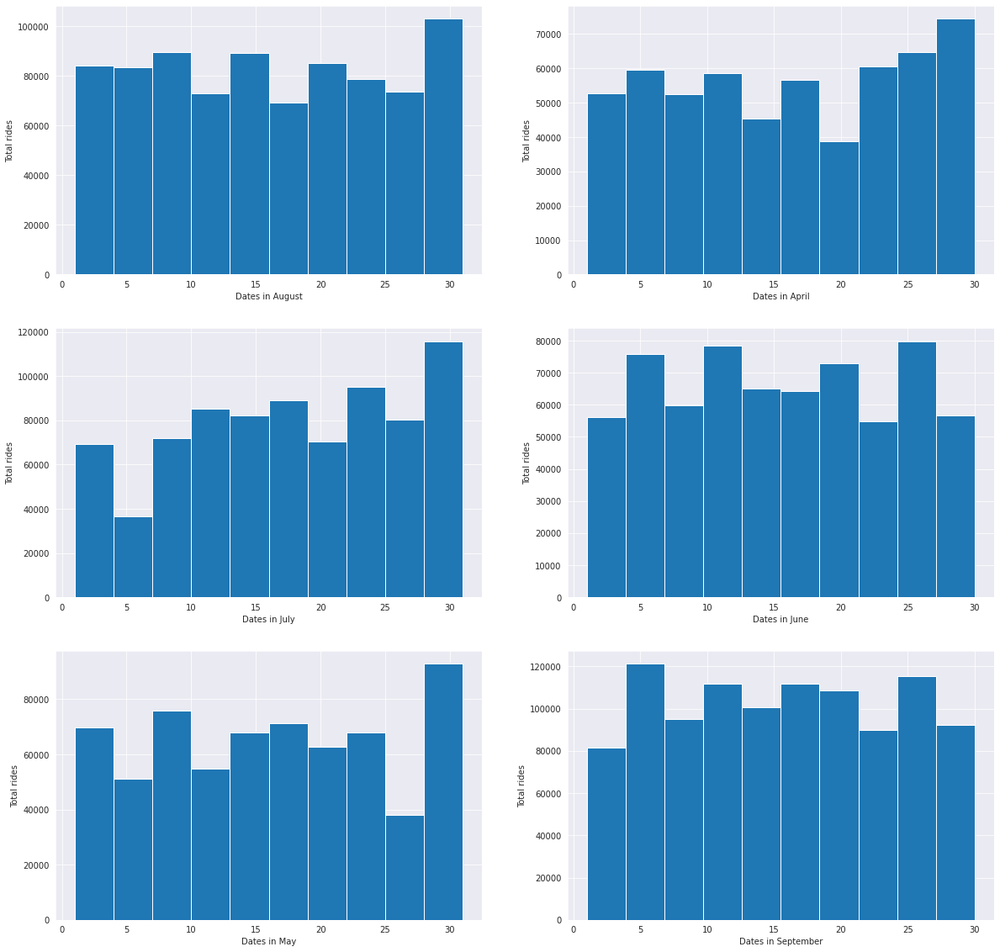

In [43]:
plt.figure(figsize=(20,20))
for i,month in enumerate(df['Month'].unique(),1):
    plt.subplot(3,2,i)
    df_out=df[df['Month']==month]
    plt.hist(df_out['Date'])
    plt.xlabel('Dates in {}'.format(month))
    plt.ylabel('Total rides')

#### Observation: The Total number of rides are maximum for each month during the end i.e., on 30th of each month.

### Analysing Rush hours in a week

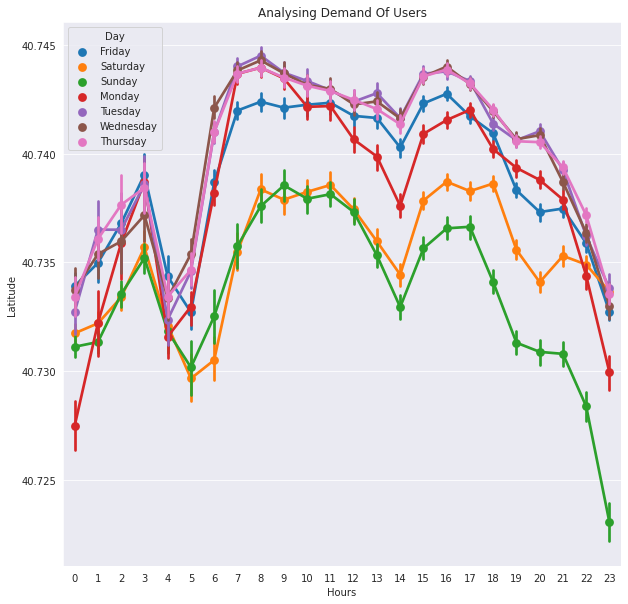

In [44]:
plt.figure(figsize=(10,10))
sns.pointplot(x="Hour",y="Latitude", hue="Day",data=df)
plt.title('Analysing Demand Of Users')
plt.xlabel("Hours")
plt.ylabel('Latitude')
plt.show()

## Analysing which base number gets popular by month name

In [45]:
df.head()

,Date/Time,Latitude,Longitude,Base,Day,Date,Month,Minute,Hour
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,Friday,1,August,3,0
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,Friday,1,August,9,0
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,Friday,1,August,12,0
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,Friday,1,August,12,0
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,Friday,1,August,12,0


In [46]:
df['Base'].head()

0    B02512
1    B02512
2    B02512
3    B02512
4    B02512
Name: Base, dtype: object

In [47]:
df.groupby(['Base','Month'])['Date/Time'].count()

Base    Month    
B02512  April         35536
        August        31472
        July          35021
        June          32509
        May           36765
        September     34370
B02598  April        183263
        August       220129
        July         245597
        June         242975
        May          260549
        September    240600
B02617  April        108001
        August       355803
        July         310160
        June         184460
        May          122734
        September    377695
B02682  April        227808
        August       173280
        July         196754
        June         194926
        May          222883
        September    197138
B02764  April          9908
        August        48591
        July           8589
        June           8974
        May            9504
        September    178333
Name: Date/Time, dtype: int64

In [48]:
base=df.groupby(['Base','Month'])['Date/Time'].count().reset_index()
base

,Base,Month,Date/Time
0,B02512,April,35536
1,B02512,August,31472
2,B02512,July,35021
3,B02512,June,32509
4,B02512,May,36765
5,B02512,September,34370
6,B02598,April,183263
7,B02598,August,220129
8,B02598,July,245597
9,B02598,June,242975


#### Analysis to get popular base number by month name

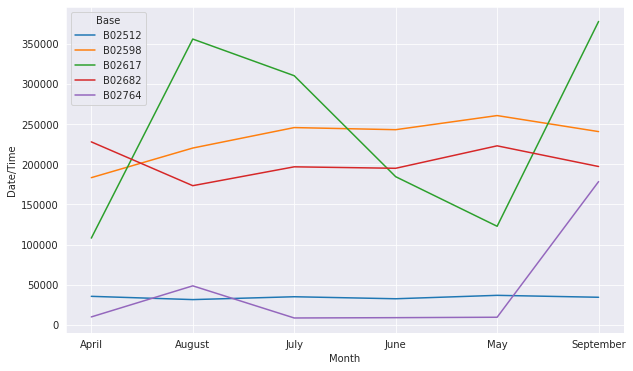

In [49]:
plt.figure(figsize=(10,6))
sns.lineplot(x='Month',y='Date/Time',hue='Base',data=base)

#### Observation: The Base Number "B02617" becomes popular by the end of the Month. The Base Number "B02512" is very low and constant entire month.

##  Cross Analysis
#### Through our exploration we are going to visualize:


#### 1.Heatmap by Hour and Day.
#### 2.Heatmap by Hour and Date.
#### 3.Heatmap by Month and Date.
#### 4.Heatmap by Month and Day.

## Heatmap by Hour and Weekday.

#### create pivot_tables

In [50]:
by_cross = df.groupby(['Day','Hour'])["Date/Time"].count()
by_cross

Day        Hour
Friday     0       13716
           1        8163
           2        5350
           3        6930
           4        8806
                   ...  
Wednesday  19      47017
           20      47772
           21      44553
           22      32868
           23      18146
Name: Date/Time, Length: 168, dtype: int64

In [51]:
pivot=by_cross.unstack()
pivot

Hour,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23
Day,,,,,,,,,,,,,,,,,,,,,,,,
Friday,13716,8163,5350,6930,8806,13450,23412,32061,31509,25230,24176,25188,25907,30341,36206,43673,48169,51961,54762,49595,43542,48323,49409,41260
Monday,6436,3737,2938,6232,9640,15032,23746,31159,29265,22197,20288,20333,20488,23385,28157,32744,38770,42023,37000,34159,32849,28925,20158,11811
Saturday,27633,19189,12710,9542,6846,7084,8579,11014,14411,17669,20596,22718,24298,26636,31418,38769,43512,42844,45883,41098,38714,43826,47951,43174
Sunday,32877,23015,15436,10597,6374,6169,6596,8728,12128,16401,19839,22856,23911,26417,28151,31112,33038,31521,28291,25948,25076,23967,19566,12166
Thursday,9293,5290,3719,5637,8505,14169,27065,37038,35431,27812,25877,25966,26465,30840,36699,44442,50560,56704,55825,51907,51990,51953,44194,27764
Tuesday,6237,3509,2571,4494,7548,14241,26872,36599,33934,25023,23676,23679,23850,29075,34846,41338,48667,55500,50186,44789,44661,39913,27712,14869
Wednesday,7644,4324,3141,4855,7511,13794,26943,36495,33826,25635,24696,24963,25533,29183,35148,43388,50684,55637,52732,47017,47772,44553,32868,18146


##### creating heatmap for data visualization

In [52]:
df.head()

,Date/Time,Latitude,Longitude,Base,Day,Date,Month,Minute,Hour
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,Friday,1,August,3,0
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,Friday,1,August,9,0
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,Friday,1,August,12,0
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,Friday,1,August,12,0
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,Friday,1,August,12,0


In [53]:
def heatmap(col1,col2):
    by_cross = df.groupby([col1,col2]).apply(lambda x:len(x))
    pivot=by_cross.unstack()
    plt.figure(figsize=(15,15))
    return sns.heatmap(pivot,annot= False,cmap="Blues")

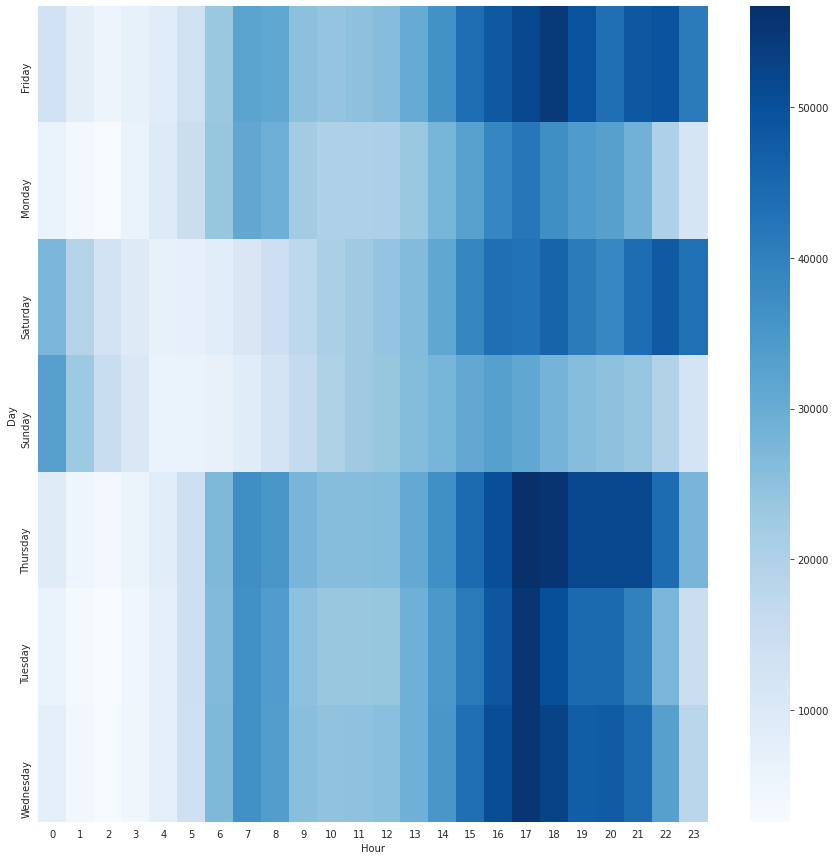

In [54]:
## validating above Analysis through Heatmap
heatmap('Day','Hour')

Observation: The number of pickups is very high at 17:00 except on sunday and very low from 1:00 to 3:00 on weekdays except the weekends i.e., on saturday and sunday.

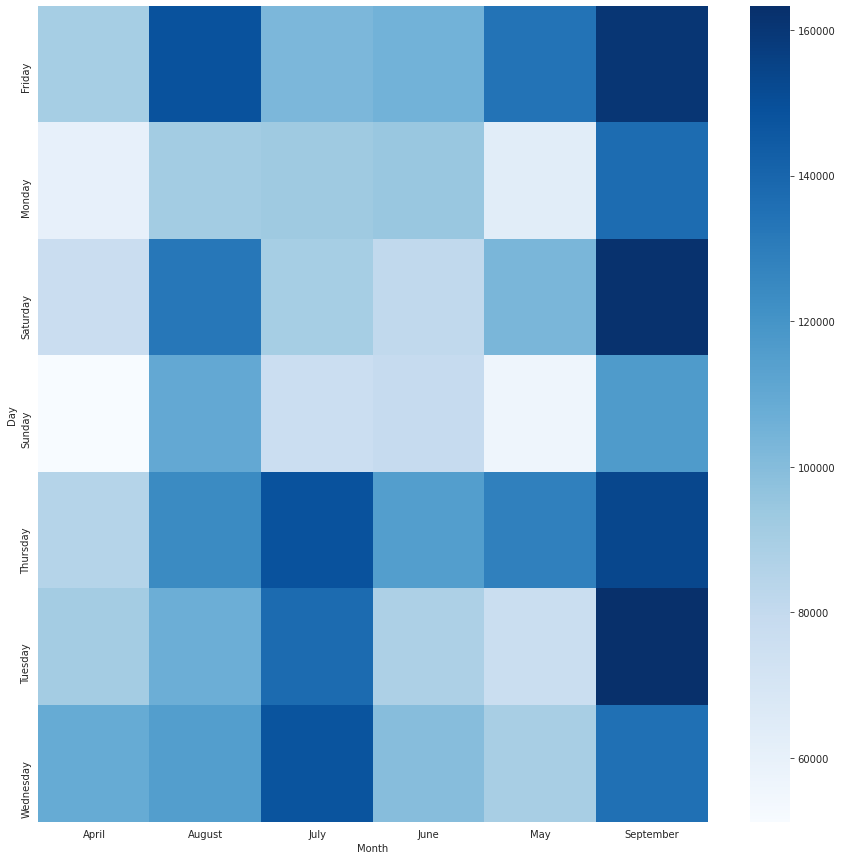

In [55]:
heatmap('Day','Month')

Observation: The number of pickups is very high in september and very low in May on sunday.

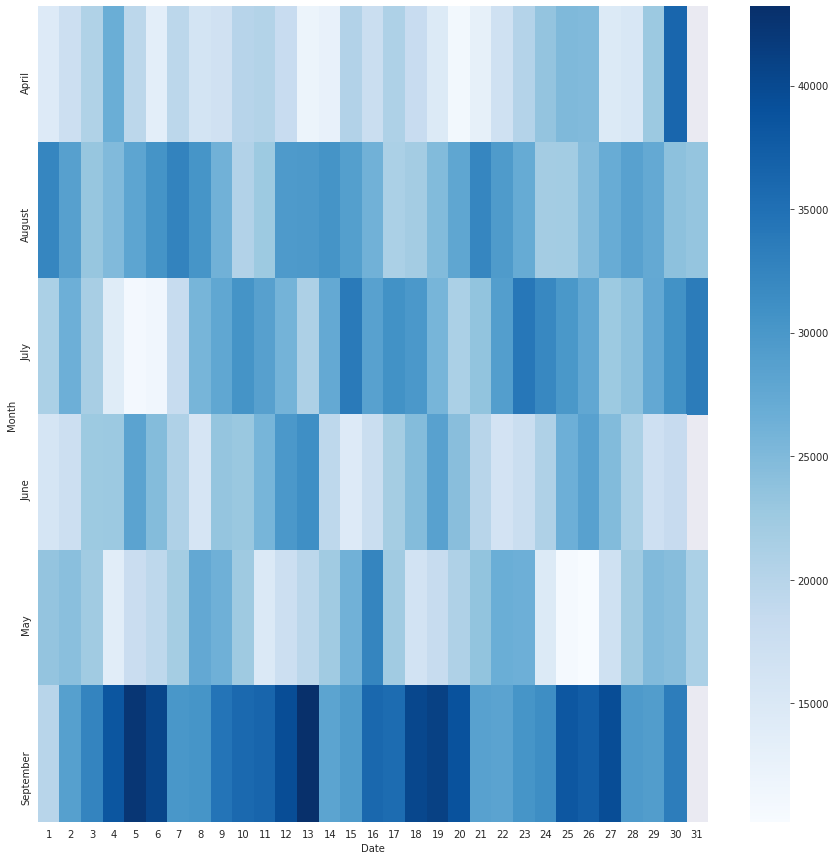

In [56]:
heatmap('Month','Date')

Observation: The number of pickups is consistently high in the month of september.

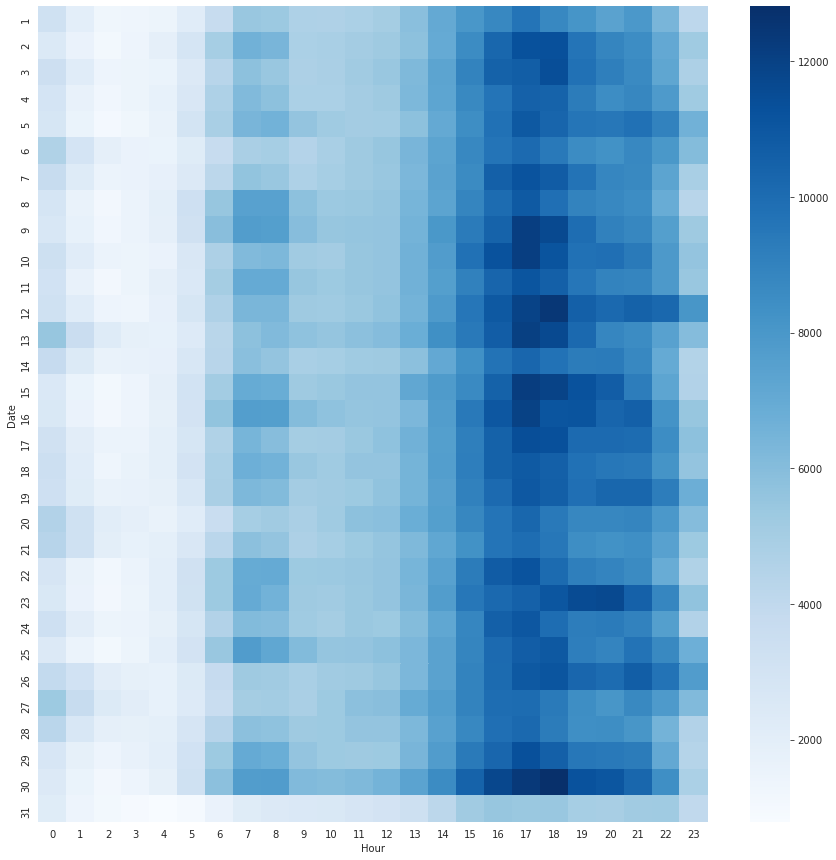

In [57]:
heatmap('Date','Hour')

Observation: The number of pickups is very high at 16:00 to 18:00 nd very low from 1:00 to 3:00 on weekdays entire month 

## Analysing the results
#### We observe that the number of trips increases each month, we can say that from April to September 2014, Uber was in a continuous improvement process.

## Analysing Location Datapoints

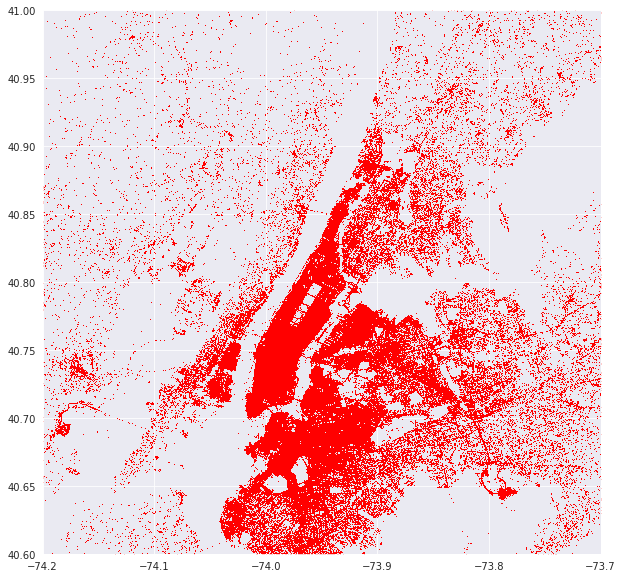

In [58]:
plt.figure(figsize=(10,10))
plt.plot(df['Longitude'], df['Latitude'],'r+', ms=0.5)
plt.xlim(-74.2, -73.7)
plt.ylim(40.6,41)
plt.show()

* The dark regions indicate the number of hot spots. 
* Midtown Manhattan is clearly a huge bright spot from Midtown to Lower Manhattan, followed by Upper Manhattan and the Heights of Brooklyn.

## Performing Spatial Analysis using heatmap to understand the Rush on Sunday(Weekend)

In [59]:
df.head()

,Date/Time,Latitude,Longitude,Base,Day,Date,Month,Minute,Hour
0,2014-08-01 00:03:00,40.7366,-73.9906,B02512,Friday,1,August,3,0
1,2014-08-01 00:09:00,40.7260,-73.9918,B02512,Friday,1,August,9,0
2,2014-08-01 00:12:00,40.7209,-74.0507,B02512,Friday,1,August,12,0
3,2014-08-01 00:12:00,40.7387,-73.9856,B02512,Friday,1,August,12,0
4,2014-08-01 00:12:00,40.7323,-74.0077,B02512,Friday,1,August,12,0


In [60]:
rush_df=df[df['Day']=='Sunday']
rush_df.head()

,Date/Time,Latitude,Longitude,Base,Day,Date,Month,Minute,Hour
2404,2014-08-03 00:03:00,40.7488,-74.0273,B02512,Sunday,3,August,3,0
2405,2014-08-03 00:04:00,40.7714,-73.9821,B02512,Sunday,3,August,4,0
2406,2014-08-03 00:06:00,40.7567,-73.9887,B02512,Sunday,3,August,6,0
2407,2014-08-03 00:07:00,40.7176,-73.9576,B02512,Sunday,3,August,7,0
2408,2014-08-03 00:08:00,40.7198,-73.9953,B02512,Sunday,3,August,8,0


In [61]:
rush_df=rush_df.groupby(['Latitude','Longitude'])['Day'].count().reset_index()

In [62]:
rush_df.columns=["Latitude","Longitude","No.of Pickups"]

In [63]:
rush_df.head()

,Latitude,Longitude,No.of Pickups
0,39.9374,-74.0722,1
1,39.9378,-74.0721,1
2,39.9384,-74.0742,1
3,39.9385,-74.0734,1
4,39.9415,-74.0736,1


In [64]:
import folium
from folium import plugins
from folium.plugins import HeatMap

In [67]:
basemap = folium.Map()

In [68]:
heat_data = [[row['Latitude'],row['Longitude'],row["No.of Pickups"]] for index, row in rush_df.iterrows()]
HeatMap(heat_data,radius=15).add_to(basemap)
basemap

#### Observation: Here we can see the rush in Midtown Manhattan and then from Midtown to Lower Manhattan, followed by Upper Manhattan and the Heights of Brooklyn. So, we can offer discounts in these regions to increase the sales.

## Analysis of Jan-June uber_15

In [69]:
uber_15 = pd.read_csv(r'./uber-pickups-in-new-york-city/uber-raw-data-janjune-15.csv',encoding='utf-8')
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID
0,B02617,2015-05-17 09:47:00,B02617,141
1,B02617,2015-05-17 09:47:00,B02617,65
2,B02617,2015-05-17 09:47:00,B02617,100
3,B02617,2015-05-17 09:47:00,B02774,80
4,B02617,2015-05-17 09:47:00,B02617,90


In [70]:
uber_15.shape

(14270479, 4)

In [71]:
#Checking the minimum date in the uber_15
uber_15['Pickup_date'].min()

'2015-01-01 00:00:05'

In [72]:
#Checking the maximum date in the uber_15
uber_15['Pickup_date'].max()

'2015-06-30 23:59:00'

In [73]:
uber_15['Pickup_date'] =  pd.to_datetime(uber_15['Pickup_date'], format='%Y-%m-%d %H:%M:%S')

In [74]:
uber_15.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270479 entries, 0 to 14270478
Data columns (total 4 columns):
 #   Column                Dtype         
---  ------                -----         
 0   Dispatching_base_num  object        
 1   Pickup_date           datetime64[ns]
 2   Affiliated_base_num   object        
 3   locationID            int64         
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 435.5+ MB


In [75]:
uber_15['Day']=uber_15['Pickup_date'].dt.day_name()
uber_15['Date']=uber_15['Pickup_date'].dt.day
uber_15['Minute']=uber_15['Pickup_date'].dt.minute
uber_15['Month']=uber_15['Pickup_date'].dt.month_name()
uber_15['Hour']=uber_15['Pickup_date'].dt.hour

In [76]:
uber_15.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,locationID,Day,Date,Minute,Month,Hour
0,B02617,2015-05-17 09:47:00,B02617,141,Sunday,17,47,May,9
1,B02617,2015-05-17 09:47:00,B02617,65,Sunday,17,47,May,9
2,B02617,2015-05-17 09:47:00,B02617,100,Sunday,17,47,May,9
3,B02617,2015-05-17 09:47:00,B02774,80,Sunday,17,47,May,9
4,B02617,2015-05-17 09:47:00,B02617,90,Sunday,17,47,May,9


In [77]:
uber_15.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14270479 entries, 0 to 14270478
Data columns (total 9 columns):
 #   Column                Dtype         
---  ------                -----         
 0   Dispatching_base_num  object        
 1   Pickup_date           datetime64[ns]
 2   Affiliated_base_num   object        
 3   locationID            int64         
 4   Day                   object        
 5   Date                  int64         
 6   Minute                int64         
 7   Month                 object        
 8   Hour                  int64         
dtypes: datetime64[ns](1), int64(4), object(4)
memory usage: 979.9+ MB


## Uber pickups by the month in NYC

In [78]:
Months_df = pd.DataFrame()
Months_df["Month"] = uber_15["Month"].value_counts().index
Months_df["Monthly Rush"] = uber_15["Month"].value_counts().values
Months_df.head()

,Month,Monthly Rush
0,June,2816895
1,May,2695553
2,April,2280837
3,February,2263620
4,March,2259773


In [79]:
fig = px.bar(Months_df,x='Month',y='Monthly Rush',title="Analysis of Rush in each Month")
fig.show()

#### Observation: We can see that the number of Uber pickups has been steadily increasing throughout the first half of 2015 in NYC i.e., from January to June.

#### Analysing Rush in New york City

In [80]:
Hours_df = pd.DataFrame()
Hours_df["Hour"] = uber_15["Hour"].value_counts().index
Hours_df["Hourly Rush"] = uber_15["Hour"].value_counts().values
Hours_df.head()

,Hour,Hourly Rush
0,19,1007464
1,18,987093
2,20,948574
3,21,930462
4,22,922954


In [81]:
fig = px.bar(Hours_df,x='Hour',y='Hourly Rush',title="Analysis of Hourly Rush")
fig.show()

##### Observation: Interestingly, after the morning rush, the number of Uber pickups doesn't dip much throughout the rest of the morning and early afternoon. There is significantly more demand in the evening than the daytime. Let's investigate to see if there's a difference in hourly pattern for different days of the week.

### Analysing In-Depth Analysis of Rush in New york City Day & hour wise

In [82]:
summary=uber_15.groupby(['Day', 'Hour'])['Pickup_date'].count().reset_index()
summary

,Day,Hour,Pickup_date
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575
...,...,...,...
163,Wednesday,19,143751
164,Wednesday,20,136003
165,Wednesday,21,133993
166,Wednesday,22,127026


In [83]:
summary=summary.rename(columns = {'Pickup_date':'Counts'})
summary.head()

,Day,Hour,Counts
0,Friday,0,85939
1,Friday,1,46616
2,Friday,2,28102
3,Friday,3,19518
4,Friday,4,23575


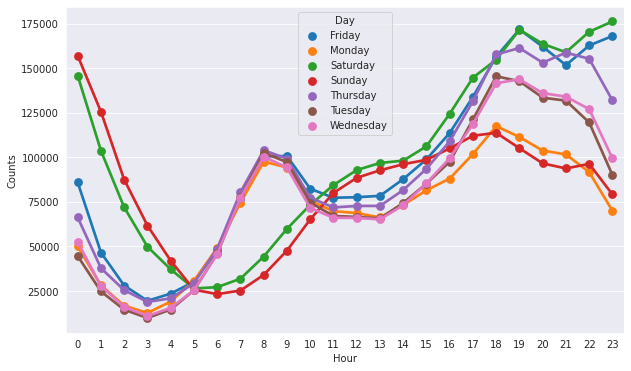

In [84]:
plt.figure(figsize=(10,6))
sns.pointplot(x="Hour", y="Counts", hue="Day", data=summary)

#### Observation: We can see that the number of Uber pickups are very high in the evening during saturday and froday and low on sunday.

## Performing In-Depth Analysis of Base Number
## Loading Uber-Jan-Feb-FOIL.csv

In [85]:
uber_foil=pd.read_csv(r'./uber-pickups-in-new-york-city/Uber-Jan-Feb-FOIL.csv')

In [86]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips
0,B02512,1/1/2015,190,1132
1,B02765,1/1/2015,225,1765
2,B02764,1/1/2015,3427,29421
3,B02682,1/1/2015,945,7679
4,B02617,1/1/2015,1228,9537


In [87]:
uber_foil['dispatching_base_number'].unique()

array(['B02512', 'B02765', 'B02764', 'B02682', 'B02617', 'B02598'],
      dtype=object)

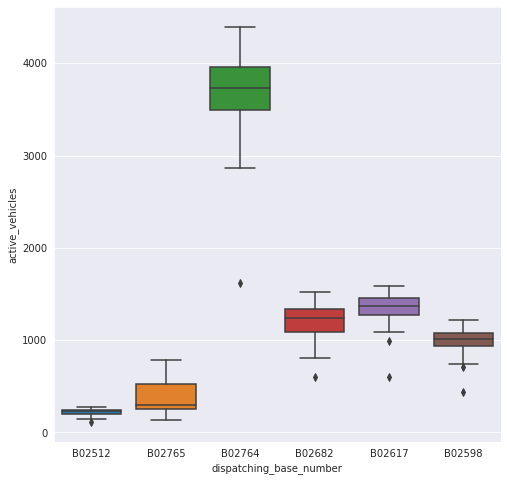

In [88]:
plt.figure(figsize=(8,8))
sns.boxplot(x = 'dispatching_base_number', y = 'active_vehicles', data = uber_foil)

#### Observation: The base number "B02764" has maximum number of active vehicles.

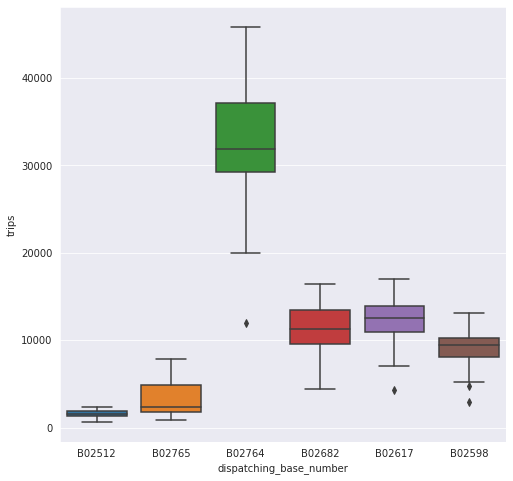

In [89]:
plt.figure(figsize=(8,8))
sns.boxplot(x = 'dispatching_base_number', y = 'trips', data = uber_foil)

#### Observation: The base number "B02764" has maximum number of trips as well.

In [90]:
# Finding the ratio of trips/active_vehicles
uber_foil['trips/vehicle'] = uber_foil['trips']/uber_foil['active_vehicles']

In [91]:
uber_foil.head()

,dispatching_base_number,date,active_vehicles,trips,trips/vehicle
0,B02512,1/1/2015,190,1132,5.957895
1,B02765,1/1/2015,225,1765,7.844444
2,B02764,1/1/2015,3427,29421,8.585060
3,B02682,1/1/2015,945,7679,8.125926
4,B02617,1/1/2015,1228,9537,7.766287


In [92]:
uber_foil.set_index('date')

,dispatching_base_number,active_vehicles,trips,trips/vehicle
date,,,,
1/1/2015,B02512,190,1132,5.957895
1/1/2015,B02765,225,1765,7.844444
1/1/2015,B02764,3427,29421,8.585060
1/1/2015,B02682,945,7679,8.125926
1/1/2015,B02617,1228,9537,7.766287
...,...,...,...,...
2/28/2015,B02764,3952,39812,10.073887
2/28/2015,B02617,1372,14022,10.220117
2/28/2015,B02682,1386,14472,10.441558


##### Analysing how Average trips/vehicle increases or decreases with dates with each of base umber

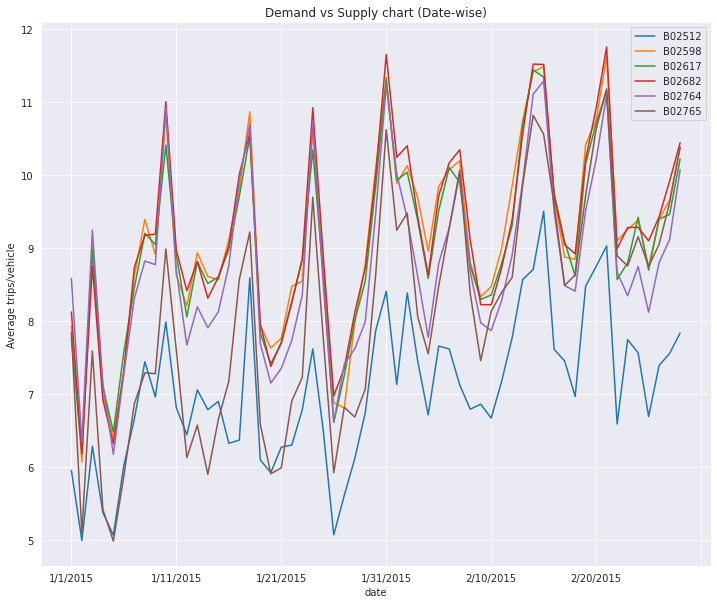

In [93]:
plt.figure(figsize=(12,10))
uber_foil.set_index('date').groupby(['dispatching_base_number'])['trips/vehicle'].plot()
plt.ylabel('Average trips/vehicle')
plt.title('Demand vs Supply chart (Date-wise)')
plt.legend()

#### Observation: The base number "B02512" has less demand compared to all the other base numbers.